In [76]:
from load import load_all_sis_data

# Load all data
all_flux_data, datetime_values, element_mapping = load_all_sis_data('flux_2014/')

print("All data shape:", all_flux_data.shape)
print("Element Mapping:", element_mapping)

All data shape: (8, 91608, 6)
Element Mapping: {'C': 0, 'Fe': 1, 'He': 2, 'N': 3, 'O': 4, 'Si': 5}


The function below identifies periods of exponential decay in a given time series of flux data.

This function uses a sliding window approach, where a fixed-size window (specified by `window_size`) is moved across the logarithmic flux data. For each position of the window, linear regression is performed on the data within the window. The regression line's slope is computed, and if this slope is less than a predefined threshold (`slope_threshold`), it indicates a significant downward trend, characteristic of an exponential decay. The start and end times of the window are recorded as a decay segment if the slope condition is met.

After identifying all potential decay segments, it proceeds to merge overlapping or adjacent segments. This step ensures that a continuous decay period is not fragmented into multiple segments. The merging process checks if the start time of a new segment is within the current segment being considered. If the segments are close enough (considering the flux increase threshold), they are merged into a single continuous segment. This merging is done iteratively to cover all identified decay periods.

In [77]:
import numpy as np
energy_level_to_compute = 1

# Precompute the Q1 values for each element
q1_values = {}
for element_name, element_index in element_mapping.items():
    valid_data_mask = (all_flux_data[energy_level_to_compute - 1, :, element_index] != -999.9) & (all_flux_data[energy_level_to_compute - 1, :, element_index] != 0)
    element_flux_for_stats = all_flux_data[energy_level_to_compute - 1, :, element_index][valid_data_mask]
    if len(element_flux_for_stats) > 0:
        q1_values[element_name] = np.percentile(element_flux_for_stats, 25)

# 3x multiplier for He and O to account for abundance
q1_values["He"] *= 3
q1_values["O"] *= 2.25
print(q1_values)

he_flux_threshold = q1_values["He"]

{'C': 8.3286e-06, 'Fe': 3.5479e-06, 'He': 8.335800000000001e-05, 'N': 7.4143e-06, 'O': 1.522125e-05, 'Si': 4.9786e-06}


Code below uses the `identify_exponential_decays` function defined above to find decay events within the entire data range (2014 to 2024) based on Helium flux at an energy level defined by `energy_level_to_compute`. The computed event windows are then stored in a Pandas dataframe. Keeps only events that are longer than the defined hours **and** where the helium (reference) flux stays above the threshold for the specified duration, then disregards the rest.

Currently, `he_flux_threshold` is defined as 3 times the Q1 upper bound for helium flux data

In [78]:
import numpy as np
import pandas as pd
from scipy.ndimage import gaussian_filter1d
from scipy.stats import linregress

def identify_exponential_decays(flux_data, time_data, window_size, slope_threshold, r_value_threshold):
    """
    Identifies exponential decay segments in flux data using linear regression.

    Args:
        flux_data (numpy.ndarray): Array of flux values.
        time_data (numpy.ndarray): Array of corresponding datetime values.
        window_size (int): Size of the sliding window for linear regression (in hours).
        slope_threshold (float): Threshold for the slope to identify a decay.

    Returns:
        list: List of tuples containing start and end times of decay segments.
    """
    flux_data = np.where(flux_data > 0, flux_data, np.nan)
    log_flux_data = np.log10(flux_data)
    log_flux_data = gaussian_filter1d(log_flux_data, sigma=1)

    decays = []
    for i in range(len(log_flux_data) - window_size):
        window = log_flux_data[i:i + window_size]
        if np.isnan(window).any():
            continue
        slope, intercept, r_value, p_value, std_err = linregress(np.arange(window_size), window)
        if slope < slope_threshold and abs(r_value) > r_value_threshold:
            start_time = time_data[i]
            end_time = time_data[i + window_size - 1]
            decays.append((start_time, end_time))

    merged_decays = []
    for start, end in decays:
        if merged_decays and start <= merged_decays[-1][1] + (time_data[1] - time_data[0]):
            merged_decays[-1] = (merged_decays[-1][0], max(merged_decays[-1][1], end))
        else:
            merged_decays.append((start, end))

    return merged_decays

def count_elements_decaying_in_window(data_3d, datetime_values, element_mapping, energy_level, start_time, end_time, window_size, slope_threshold, r_value_threshold):
    """
    Counts the number of elements with exponential decays within a given time window.
    
    Args:
        data_3d (numpy.ndarray): The 3D data cube (energy, time, element).
        datetime_values (numpy.ndarray): Array of datetime objects.
        element_mapping (dict): Element name to array index mapping.
        energy_level (int): The energy level to analyze.
        start_time (pd.Timestamp): Start time for the time window.
        end_time (pd.Timestamp): End time for the time window.
        window_size (int): Size of the sliding window for decay detection (in hours).
        slope_threshold (float): Threshold for the slope to identify a decay.

    Returns:
        set: The set of elements that decay within the time window.
    """
    time_mask = (datetime_values >= start_time) & (datetime_values <= end_time)
    decaying_elements = set()

    for element_name, element_index in element_mapping.items():
        if element_name == 'He':
            continue

        element_flux = data_3d[energy_level - 1, time_mask, element_index]
        valid_data_mask = element_flux != -999.9
        element_flux = element_flux[valid_data_mask]
        element_time = datetime_values[time_mask][valid_data_mask]

        if len(element_flux) == 0:
            continue

        decays = identify_exponential_decays(element_flux, element_time, window_size=18, slope_threshold=slope_threshold, r_value_threshold=r_value_threshold)
        if len(decays) > 0:
            decaying_elements.add(element_name)

    return decaying_elements

def compute_decay_events_for_all_data(data_3d, datetime_values, element_mapping, energy_level, he_flux_threshold, min_duration_hours, window_size, slope_threshold, r_value_threshold):
    """
    Computes decay events for all available data, keeping only events where helium flux stays above the threshold
    for the specified duration, and counts the number of elements with exponential decays in each window.
    
    Args:
        data_3d (numpy.ndarray): The 3D data cube (energy, time, element).
        datetime_values (numpy.ndarray): Array of datetime objects.
        element_mapping (dict): Element name to array index mapping.
        energy_level (int): The energy level to analyze.
        he_flux_threshold (float): Minimum helium flux threshold.
        min_duration_hours (int): Minimum duration (hours) above threshold.
        window_size (int): Size of the sliding window for decay detection (in hours).
        slope_threshold (float): Threshold for the slope to identify a decay.

    Returns:
        pd.DataFrame: DataFrame with decay event details including the number of elements decaying and non-decaying elements.
    """
    helium_index = element_mapping['He']
    helium_flux = data_3d[energy_level - 1, :, helium_index]
    
    valid_data_mask = helium_flux != -999.9
    helium_flux = helium_flux[valid_data_mask]
    helium_time = datetime_values[valid_data_mask]
    
    if len(helium_flux) == 0:
        print("No valid helium data available.")
        return pd.DataFrame()
    
    decay_segments = identify_exponential_decays(helium_flux, helium_time, window_size, slope_threshold, r_value_threshold)
    decay_event_details = []

    all_elements = set(element_mapping.keys()) - {'He'}

    for event_number, (start, end) in enumerate(decay_segments):
        start_index = np.where(helium_time == start)[0][0]
        end_index = np.where(helium_time == end)[0][0]

        above_threshold_mask = helium_flux[start_index:end_index] >= he_flux_threshold
        above_threshold_times = helium_time[start_index:end_index][above_threshold_mask]

        duration_above_threshold = 0
        if len(above_threshold_times) > 1:
            time_differences = np.diff(above_threshold_times)
            continuous_periods = np.where(time_differences <= pd.Timedelta(hours=1))[0]
            if len(continuous_periods) > 0:
                duration_above_threshold = (
                    above_threshold_times[continuous_periods[-1] + 1] - above_threshold_times[0]
                ).total_seconds() / 3600

        decaying_elements = count_elements_decaying_in_window(
            data_3d, datetime_values, element_mapping, energy_level, start, end, window_size, slope_threshold, r_value_threshold
        )

        non_decaying_elements = all_elements - decaying_elements
        non_decaying_elements_list = list(non_decaying_elements)

        if duration_above_threshold >= min_duration_hours:
            start_year = start.year
            end_year = end.year
            start_frac_day = (
                start.timetuple().tm_yday
                + start.hour / 24
                + start.minute / 1440
                + start.second / 86400
            )
            end_frac_day = (
                end.timetuple().tm_yday
                + end.hour / 24
                + end.minute / 1440
                + end.second / 86400
            )
            start_hour = start.hour + start.minute / 60 + start.second / 3600
            end_hour = end.hour + end.minute / 60 + end.second / 3600

            decay_event_details.append(
                {
                    "Event Number": event_number + 1,
                    "Start Year": start_year,
                    "End Year": end_year,
                    "Start Fractional Day": start_frac_day,
                    "End Fractional Day": end_frac_day,
                    "Start Hour": start_hour,
                    "End Hour": end_hour,
                    "Elements Decaying": len(decaying_elements) + 1,
                    "Non-Decaying Elements": non_decaying_elements_list
                }
            )

    decay_events_df = pd.DataFrame(decay_event_details)
    return decay_events_df

# Parameters
energy_level_to_compute = 1
min_duration_hours = 48
window_size = 24  # hours
slope_threshold = -0.005
r_value_threshold = 0.0

# Compute decay events with the new parameters
decay_events_df = compute_decay_events_for_all_data(all_flux_data, datetime_values, element_mapping, energy_level_to_compute, he_flux_threshold, min_duration_hours, window_size, slope_threshold, r_value_threshold)

# Fix columns from wrapping
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 1000)
pd.set_option('display.colheader_justify', 'center')

print(decay_events_df)
decay_events_df.to_csv('transformed_data/uncleaned_decay_events_14.csv', index=False)


     Event Number  Start Year  End Year  Start Fractional Day  End Fractional Day  Start Hour  End Hour   Elements Decaying Non-Decaying Elements
0           1         2014       2014           1.000000             4.958333        0.000000  23.000000          1            [Si, N, Fe, C, O] 
1           3         2014       2014           8.833333            20.750000       20.000000  18.000000          6                           [] 
2           4         2014       2014          21.333322            25.041667        7.999722   1.000000          1            [Si, N, Fe, C, O] 
3           5         2014       2014          25.541655            29.291667       12.999722   7.000000          1            [Si, N, Fe, C, O] 
4           7         2014       2014          35.833333            39.499988       20.000000  11.999722          1            [Si, N, Fe, C, O] 
..            ...         ...       ...                   ...                 ...         ...        ...                ... 

Code below plots all the identified decay events in a grid, each plot showing fluxes of all elements,
    with formatted x-axis ticks showing day of year, and includes 1 day before/after each event
    separated by vertical lines.

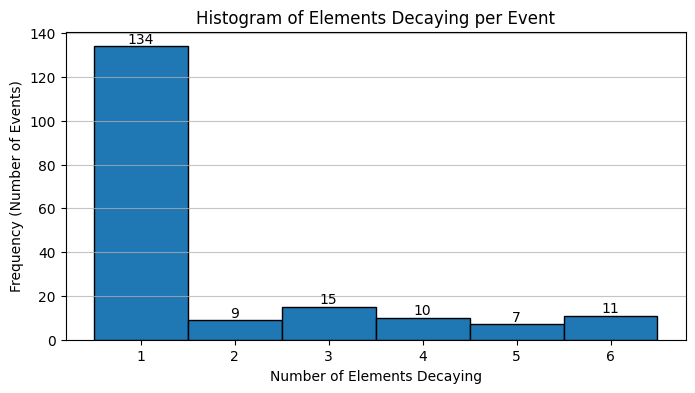

In [79]:
import pandas as pd
import matplotlib.pyplot as plt

# Plotting the histogram
plt.figure(figsize=(8, 4))
counts, bins, patches = plt.hist(decay_events_df['Elements Decaying'], bins=range(1, decay_events_df['Elements Decaying'].max() + 2), align='left', edgecolor='black')
plt.title('Histogram of Elements Decaying per Event')
plt.xlabel('Number of Elements Decaying')
plt.ylabel('Frequency (Number of Events)')
plt.xticks(range(1, decay_events_df['Elements Decaying'].max() + 1))
plt.grid(axis='y', alpha=0.75)

# Annotating the bars with their frequencies
for count, bin_edge in zip(counts, bins):
    if count > 0:
        plt.text(bin_edge, count, f'{int(count)}', ha='center', va='bottom')

plt.show()


In [5]:
from graph import plot_all_decay_events

energy_level_to_plot = 1
extend_days = 1  # Adjust the number of days to extend before and after
print(f"Graph of flux events using data from energy level {energy_level_to_plot} and using data from Helium at energy level {energy_level_to_compute} for cutoffs")
# plot_all_decay_events(decay_events_df, all_flux_data, datetime_values, element_mapping, energy_level_to_plot, extend_days, True)

Graph of flux events using data from energy level 1 and using data from Helium at energy level 1 for cutoffs


    Event Number  Start Year  End Year  Start Fractional Day  End Fractional Day  Start Hour  End Hour   Elements Decaying Non-Decaying Elements
0          5         2014       2014          25.541655            29.291667       12.999722   7.000000          1            [Si, N, Fe, C, O] 
1         25         2014       2014         192.833333           195.583322       20.000000  13.999722          1            [Si, N, Fe, C, O] 
2         37         2014       2014         286.000000           289.749988        0.000000  17.999722          1            [Si, N, Fe, C, O] 
3         38         2014       2014         292.333333           294.791667        8.000000  19.000000          2               [C, Si, N, Fe] 
4         42         2014       2014         327.791655           329.875000       18.999722  21.000000          1            [Si, N, Fe, C, O] 
5         55         2015       2015          35.999988            38.374988       23.999722   8.999722          1            [Si,

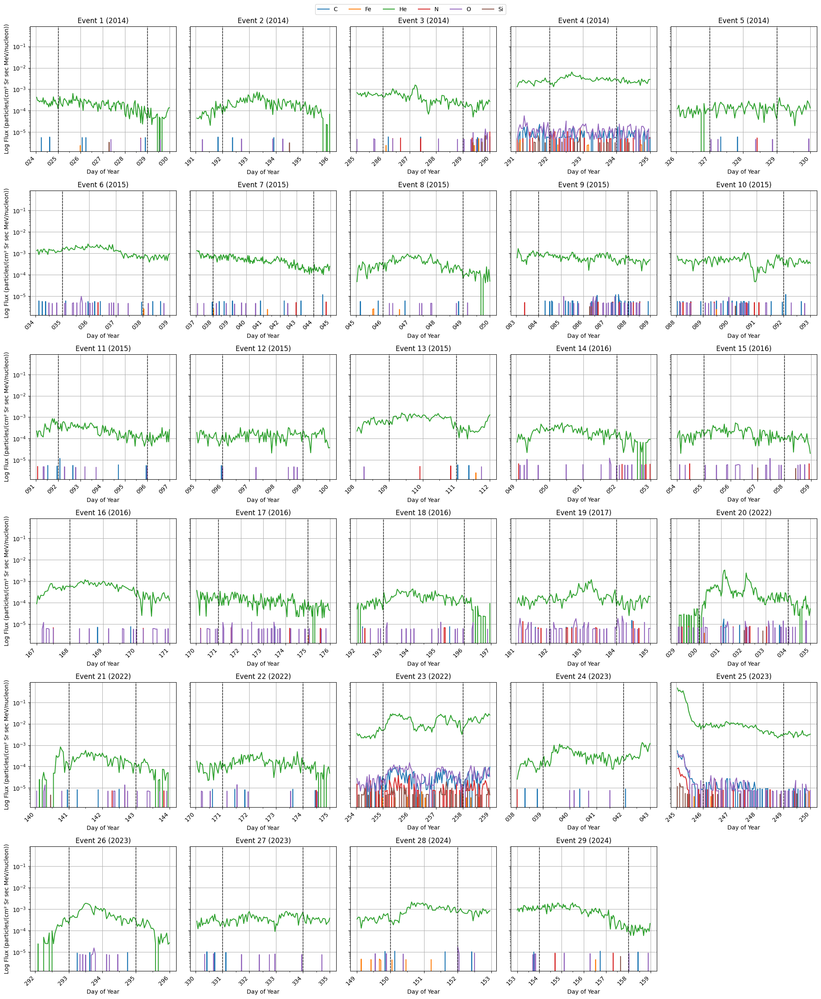

In [6]:
import pandas as pd

indices_to_keep = [3, 16, 23, 24, 28, 35, 36, 37, 41, 42, 43, 44, 46, 64, 65, 69, 70, 71, 86, 108, 117, 119, 124, 136, 153, 159, 163, 183, 184]
# indices_to_keep = [3, 16, 28, 35, 36, 37, 41, 42, 43, 44, 46, 64, 65, 69, 70, 71, 86, 108, 117, 119, 121, 136, 153, 159, 163, 183, 184]
bad_df = decay_events_df.iloc[indices_to_keep]
bad_df.reset_index(drop=True, inplace=True)

print(bad_df)
plot_all_decay_events(bad_df, all_flux_data, datetime_values, element_mapping, energy_level_to_plot, extend_days, True)

In [7]:
import plotly.graph_objects as go
import pandas as pd
from plotly.subplots import make_subplots

def create_interactive_plot_with_events(data_3d, datetime_values, element_mapping, energy_level, start_time, end_time, output_html, decay_events_df):
    """
    Creates an interactive Plotly plot of flux data with start (green) and stop (red) lines for events 
    from the provided decay_events_df DataFrame.
    
    Args:
        data_3d (numpy.ndarray): The 3D data cube (energy, time, element).
        datetime_values (numpy.ndarray): Array of datetime objects.
        element_mapping (dict): Element name to array index mapping.
        energy_level (int): The energy level to analyze.
        start_time (pd.Timestamp): Start time for the plot range.
        end_time (pd.Timestamp): End time for the plot range.
        output_html (str): Path to the output HTML file.
        decay_events_df (pd.DataFrame): DataFrame containing decay events with columns 'Start Year', 'End Year', 
                                        'Start Fractional Day', 'End Fractional Day', 'Start Hour', 'End Hour'.
    """
    # Time mask
    time_mask = (datetime_values >= start_time) & (datetime_values <= end_time)
    
    # Helium flux
    helium_index = element_mapping['He']
    helium_flux = data_3d[energy_level - 1, time_mask, helium_index]
    
    # Omit bad data points
    valid_data_mask = helium_flux != -999.9
    helium_flux = helium_flux[valid_data_mask]
    helium_time = datetime_values[time_mask][valid_data_mask]

    if len(helium_flux) == 0:
        print("No valid helium data in the specified time range.")
        return

    # Create the Plotly figure
    fig = make_subplots(rows=1, cols=1)

    # Plot the helium flux data
    fig.add_trace(go.Scatter(x=helium_time, y=helium_flux, mode='lines', name='Helium Flux', line=dict(color='blue')))
    
    # Plot the start and stop lines for decay events from decay_events_df
    for _, row in decay_events_df.iterrows():
        start_year = int(row['Start Year'])
        end_year = int(row['End Year'])
        start_frac_day = row['Start Fractional Day']
        end_frac_day = row['End Fractional Day']
        start_hour = row['Start Hour']
        end_hour = row['End Hour']
        
        # Convert fractional days and hours to datetime
        start_datetime = pd.to_datetime(f'{start_year}-01-01') + pd.to_timedelta(start_frac_day - 1, unit='D') + pd.to_timedelta(start_hour, unit='h')
        end_datetime = pd.to_datetime(f'{end_year}-01-01') + pd.to_timedelta(end_frac_day - 1, unit='D') + pd.to_timedelta(end_hour, unit='h')
        
        fig.add_trace(go.Scatter(x=[start_datetime, start_datetime], y=[min(helium_flux), max(helium_flux)], 
                                 mode='lines', name='Decay Start', line=dict(color='green', dash='dash'), showlegend=False))
        fig.add_trace(go.Scatter(x=[end_datetime, end_datetime], y=[min(helium_flux), max(helium_flux)], 
                                 mode='lines', name='Decay End', line=dict(color='red', dash='dash'), showlegend=False))
    
    # Plot other elements
    for element_name, element_index in element_mapping.items():
        if element_name == 'He':
            continue
        
        element_flux = data_3d[energy_level - 1, time_mask, element_index]
        valid_data_mask = element_flux != -999.9
        element_flux = element_flux[valid_data_mask]
        element_time = datetime_values[time_mask][valid_data_mask]

        if len(element_flux) == 0:
            continue
        
        fig.add_trace(go.Scatter(x=element_time, y=element_flux, mode='lines', name=f'{element_name} Flux'))

    # Update layout for better visibility and horizontal scrolling
    fig.update_layout(
        title=f'Flux Data with Decay Events (Energy Level {energy_level})',
        xaxis_title='Time',
        yaxis_title='Flux (particles/(cm² Sr sec MeV/nucleon))',
        yaxis_type='log',  # Set y-axis to log scale
        xaxis=dict(rangeslider=dict(visible=True)),
        autosize=False,
        width=1500,
        height=600,
        margin=dict(l=50, r=50, b=50, t=50, pad=4)
    )

    # Save and show the plot
    fig.write_html(output_html)
    fig.show()


energy_level_to_plot = 1
start_time = pd.to_datetime('2014-01-01')
end_time = pd.to_datetime('2024-12-31')
output_html = 'web_plot.html'  


create_interactive_plot_with_events(all_flux_data, datetime_values, element_mapping, energy_level_to_plot, start_time, end_time, output_html, decay_events_df)


c:\Users\jeffr\AppData\Local\Programs\Python\Python311\Lib\site-packages\plotly\io\_json.py:560: UserWarning:

Discarding nonzero nanoseconds in conversion.



In [80]:
def filter_by_elements_decaying(decay_events_df, min_elements_decaying_list):
    # Filter the DataFrame based on any of the minimum thresholds
    filtered_df = decay_events_df[decay_events_df['Elements Decaying'].isin(min_elements_decaying_list)]

    # Reset the index of the filtered DataFrame
    filtered_df = filtered_df.reset_index(drop=True)
    return filtered_df

min_elements_decaying_list = [4,5,6]  # Set the thresholds for elements decaying
filtered_df = filter_by_elements_decaying(decay_events_df, min_elements_decaying_list)

print(filtered_df)
filtered_df.to_csv('transformed_data/filtered_decay_events.csv', index=False)


    Event Number  Start Year  End Year  Start Fractional Day  End Fractional Day  Start Hour  End Hour   Elements Decaying Non-Decaying Elements
0          3         2014       2014           8.833333            20.750000       20.000000  18.000000          6                      []      
1         12         2014       2014          59.458333            74.833333       11.000000  20.000000          6                      []      
2         18         2014       2014         109.625000           117.875000       15.000000  21.000000          4                [Si, Fe]      
3         29         2014       2014         250.750000           254.083333       18.000000   2.000000          4                [Si, Fe]      
4         30         2014       2014         255.041667           263.416655        1.000000   9.999722          4                 [Si, N]      
5         40         2014       2014         306.000000           312.791655        0.000000  18.999722          5                

Graph of flux events using data from energy level 1 and using data from Helium at energy level 1 for cutoffs


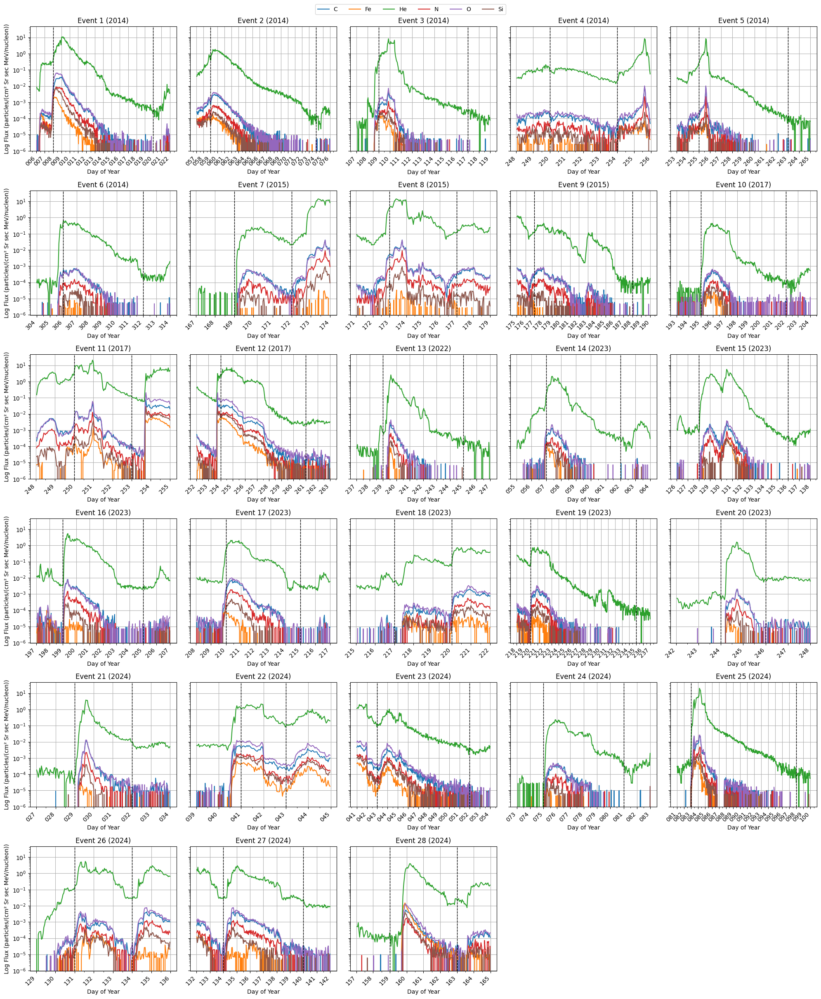

In [9]:
from graph import plot_all_decay_events

energy_level_to_plot = 1
extend_days = 2  # Adjust the number of days to extend before and after
print(f"Graph of flux events using data from energy level {energy_level_to_plot} and using data from Helium at energy level {energy_level_to_compute} for cutoffs")
plot_all_decay_events(filtered_df, all_flux_data, datetime_values, element_mapping, energy_level_to_plot, extend_days, True)

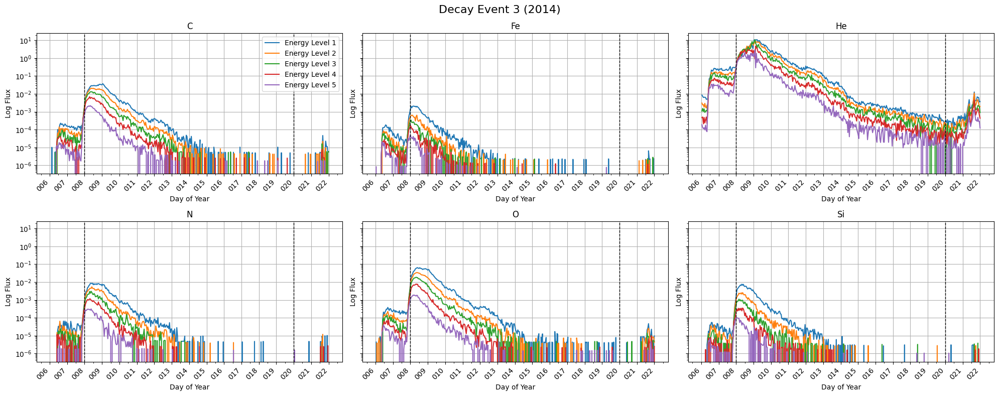

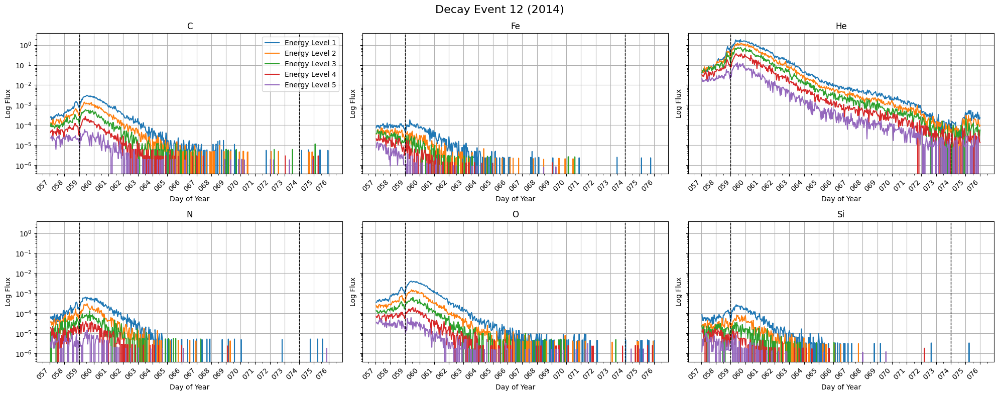

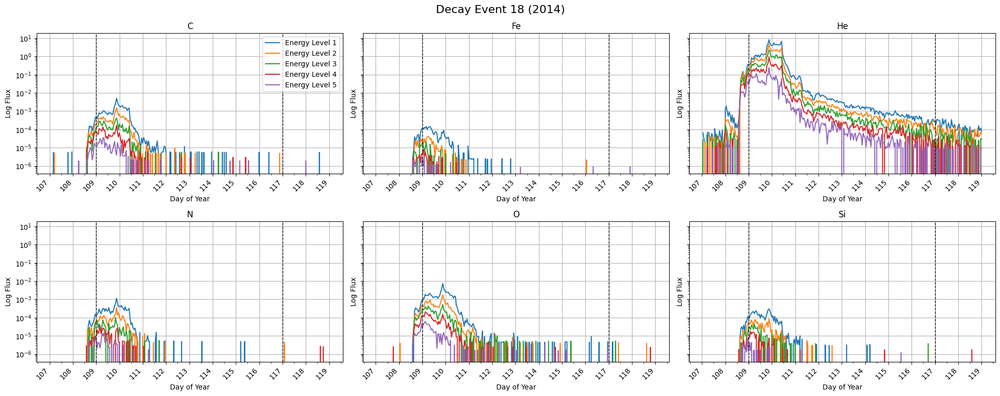

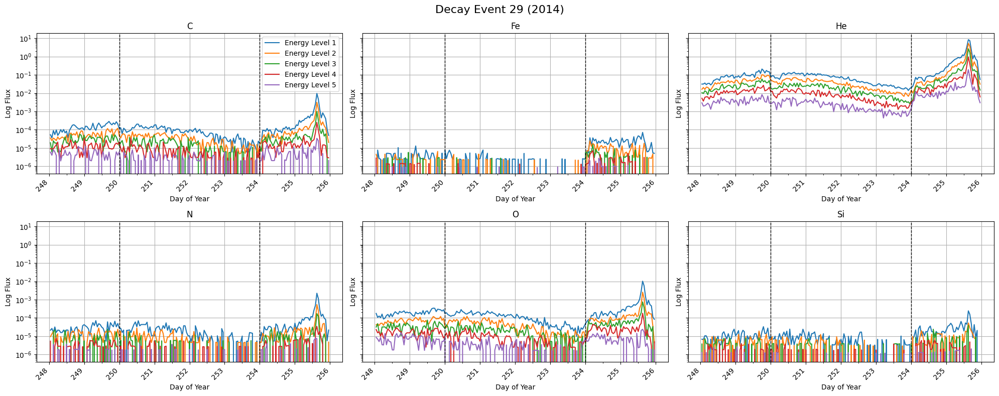

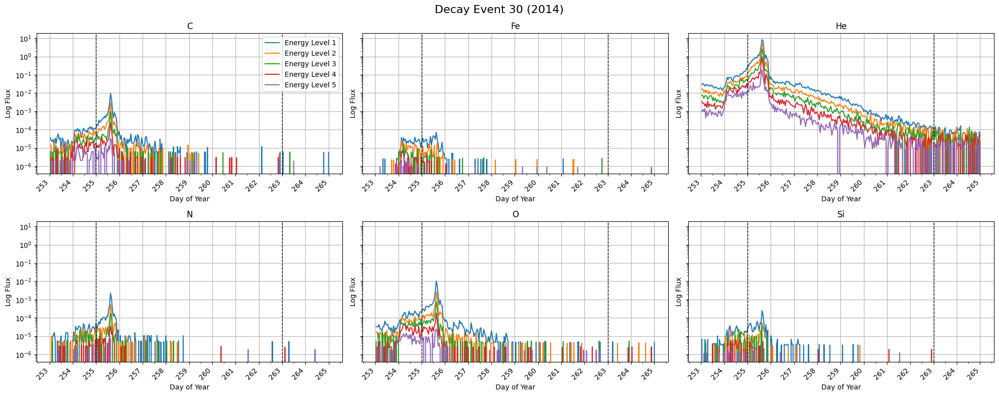

...

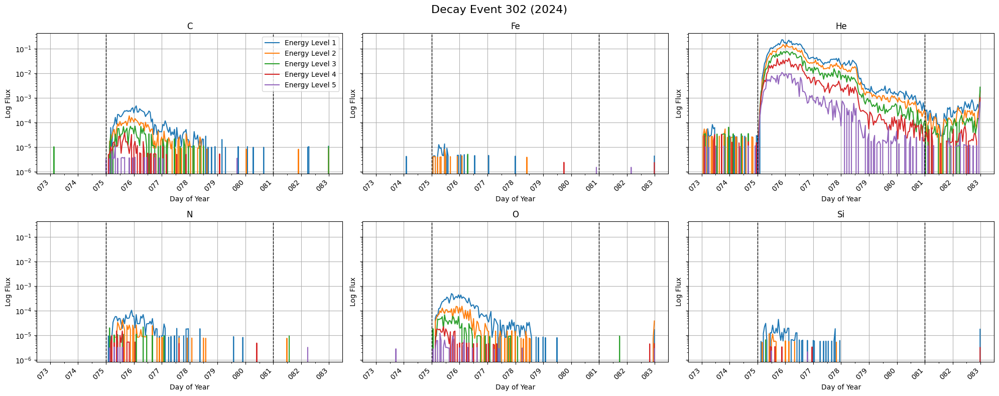

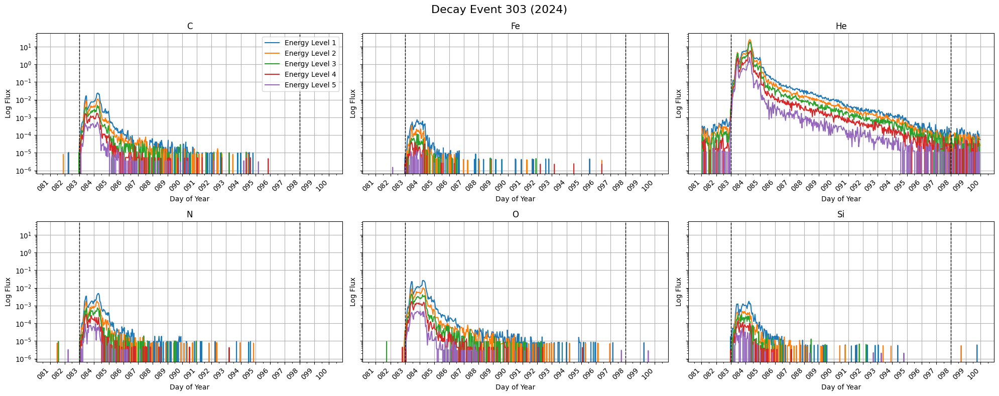

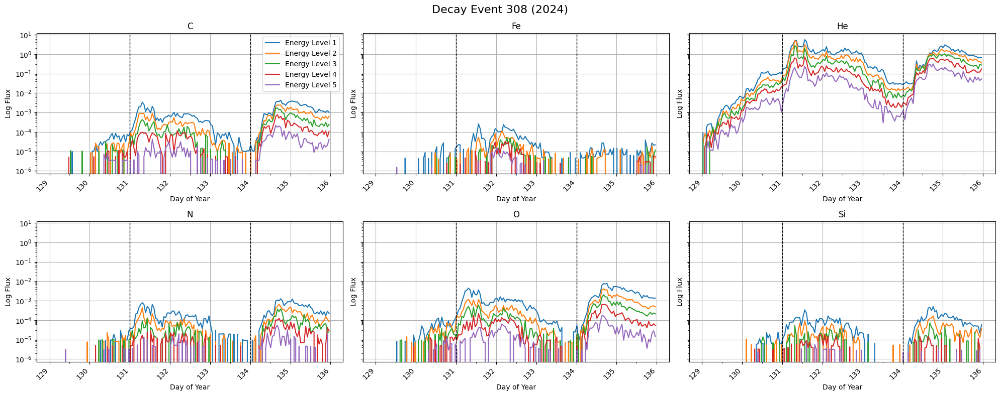

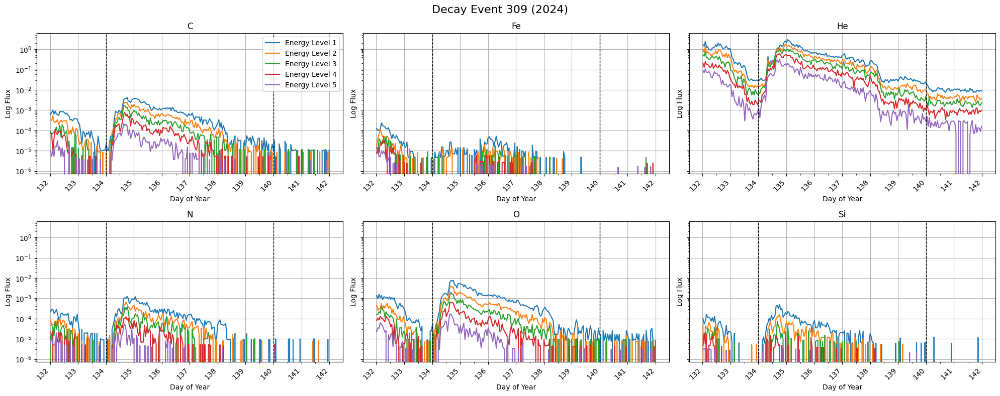

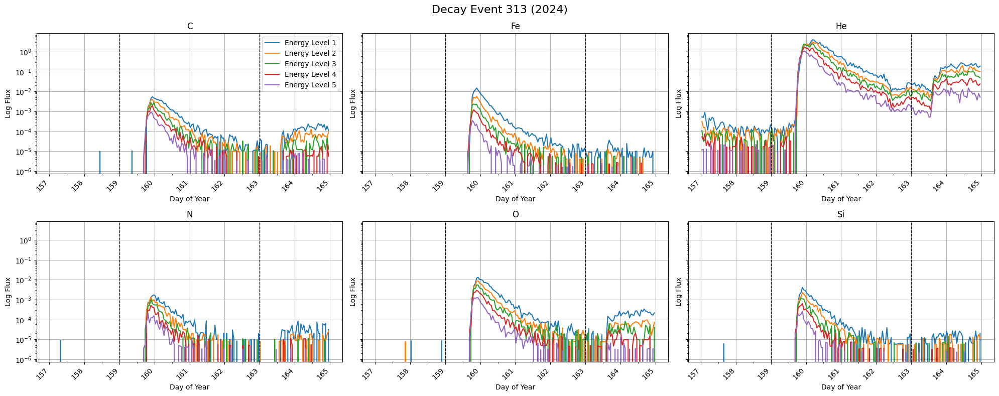

In [10]:
from graph import plot_decay_events_per_element

# Parameters
energy_levels_to_plot = 5  # Number of lowest energy levels to plot
extend_days = 2  # Extend the time range by 2 days before and after the event
useLogScale = True  # Whether to use a logarithmic scale for the y-axis

# Plot the decay events
plot_decay_events_per_element(filtered_df, all_flux_data, datetime_values, element_mapping, energy_levels_to_plot, extend_days, useLogScale)


In [11]:
import pandas as pd

raw_combined_df = pd.concat([bad_df, filtered_df], ignore_index=True)
print(raw_combined_df)

    Event Number  Start Year  End Year  Start Fractional Day  End Fractional Day  Start Hour  End Hour   Elements Decaying Non-Decaying Elements
0          5         2014       2014          25.541655            29.291667       12.999722   7.000000          1            [Si, N, Fe, C, O] 
1         25         2014       2014         192.833333           195.583322       20.000000  13.999722          1            [Si, N, Fe, C, O] 
2         37         2014       2014         286.000000           289.749988        0.000000  17.999722          1            [Si, N, Fe, C, O] 
3         38         2014       2014         292.333333           294.791667        8.000000  19.000000          2               [C, Si, N, Fe] 
4         42         2014       2014         327.791655           329.875000       18.999722  21.000000          1            [Si, N, Fe, C, O] 
5         55         2015       2015          35.999988            38.374988       23.999722   8.999722          1            [Si,

In [12]:
import numpy as np
import pandas as pd
from features import create_dataframe

element_energy_decay_df = create_dataframe(filtered_df, datetime_values, all_flux_data, element_mapping, 1)
bad_element_energy_decay_df = create_dataframe(bad_df, datetime_values, all_flux_data, element_mapping, 0)

combined_df = pd.concat([element_energy_decay_df, bad_element_energy_decay_df], ignore_index=True)

# Shuffle the rows randomly
shuffled_indices = np.random.permutation(combined_df.index)
combined_df = combined_df.reindex(shuffled_indices).reset_index(drop=True)

combined_df.to_csv("transformed_data/decay_input_features_2014.csv", index=False)
print(combined_df)


      Event ID  Element  Duration  Max Flux  Initial Decay Rate  Average Decay Rate  Time to Peak  Peak Prominence  Number of Peaks  Skewness  Kurtosis     Std Flux    Median Flux  Normalized Time to Peak  Decay Rate 25%  Decay Rate 50%  Decay Rate 75%  Avg Decay Percentages  Target Label
0         70       3         72    0.000000       0.000000          0.000000e+00           0          0.000000             0              NaN        NaN  0.000000e+00   0.000000           0.000000           0.000000e+00    0.000000e+00    0.000000e+00       0.000000e+00             0     
1         83       4        263    0.000889      -0.000019          1.390875e-06          23          0.000889            66         2.224136   4.074114  1.973568e-04   0.000014           0.087452           3.664943e-06    2.781749e-06    1.854499e-06       2.767064e-06             1     
2        267       4         48    0.002040      -0.000017         -3.014792e-07          17          0.002040            10      